## To change the collection this notebook pulls data for all you have to do is replace 'asset_contract_address' + finding and replacing all mention of 'animeta' with an identifier of the contract in the full notebook

### *Note: You will have to change the start and and dates as well for data pulling. The initial query could take some time and require additional sleep between loops to not throttle but once pulled and saved you can set dates to only query new data. 

## Notebook Functionalities:
* [Pull and Save NFT Data](#get-nft)
* [Pull and Save NFT Sales](#get-sales)
* [Pull and Save NFT Listings](#get-listings)
* [Load and Pre-Process Data](#load)
* [Basic Analysis](#analysis)
* [Macro Visualization](#visual)
* [Sales by Trait](#trait)

In [6]:
%matplotlib inline

In [1]:
from helpers import parse_animetas_data, parse_sale_data, parse_listing_data

import requests
import pandas as pd
from pandas_profiling import ProfileReport
import pickle

from statistics import *
import numpy as np
from scipy.stats import combine_pvalues

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
plt.style.use('ggplot')

import time
from datetime import date, timedelta, datetime

import os
import glob

## Pull and Save NFT Data <a class="anchor" id="get-nft"></a>

#### Getting Animetas Assets Data

The code below collects assets data about the 10,101 Animetas. The API has a limit of 50 items per call, and therefore we need to create a loop with 204 iterations to collect all Animetas data. Animeta ID 0 - 10100

##### Animeta Data Parsed:
- 'animeta_id'
- 'creator_username'
- 'creator_address'
- 'owner_username'
- 'owner_address'
- 'traits'
- 'num_sales'

In [2]:
url = "https://api.opensea.io/api/v1/assets"

querystring = {"token_ids":list(range(0, 30)),
               "asset_contract_address":"0x18df6c571f6fe9283b87f910e41dc5c8b77b7da5",
               "order_direction":"desc",
               "offset":"0",
               "limit":"30"}
response = requests.request("GET", url, params=querystring)


# Getting animetas data
listings = response.json()['assets']
if listings == []:
    print('empty')
# Parsing animetas data

In [13]:
len_collection = 10101

In [35]:
def compute_rarity(asset, len_collection):
    '''
    get the p value for each trait of an asset and combine them using fishers method into a rarity score
    NOT INCLUDED: count of traits contributes to overall rarity
        could be helpful to look at number of traits compared to avg & max trait counts
    '''
    p_values = []
    for trait in asset['traits']:
        p_val = (trait['trait_count'] / len_collection)
        p_values.append(p_val)
    return combine_pvalues(p_values)

In [44]:
top_5 = [[0,''],[0,''],[0,''],[0,''],[0,'']]
for index,animeta in animetas_df.iterrows():
    rarity = compute_rarity(animeta, len_collection)
    for idx,i in enumerate(top_5):
        if rarity[0] > i[0]:
            top_5[idx][0] = rarity[0]
            top_5[idx][1] = animeta['animeta_id']
            break
top_5.sort(reverse=True)
print(top_5)

[[148.03031965135202, '7239'], [136.48266195713802, '3926'], [130.33337223088915, '6114'], [130.13889557356586, '6424'], [126.64190334276972, '6588']]


In [28]:
listings[0]

{'id': 33619906,
 'token_id': '26',
 'num_sales': 0,
 'background_color': None,
 'image_url': 'https://lh3.googleusercontent.com/SEpYcwGMcQo642-2g2Q732AOz3db1lptVZZLHgrr-xaP7mCytYlG-3ZnBqgiZEMSgtYxPNED8t-a-glEHyKbvCFb18ss5Sh6chRxgg',
 'image_preview_url': 'https://lh3.googleusercontent.com/SEpYcwGMcQo642-2g2Q732AOz3db1lptVZZLHgrr-xaP7mCytYlG-3ZnBqgiZEMSgtYxPNED8t-a-glEHyKbvCFb18ss5Sh6chRxgg=s250',
 'image_thumbnail_url': 'https://lh3.googleusercontent.com/SEpYcwGMcQo642-2g2Q732AOz3db1lptVZZLHgrr-xaP7mCytYlG-3ZnBqgiZEMSgtYxPNED8t-a-glEHyKbvCFb18ss5Sh6chRxgg=s128',
 'image_original_url': 'https://gateway.pinata.cloud/ipfs/QmbfuMdX9qiMmKVcDiWmQHYg6sk5yfmoAh7fYbQcvWd9gd/26.png',
 'animation_url': None,
 'animation_original_url': None,
 'name': 'Animeta #26',
 'description': 'Animetas is a generative collection of 10101 unique 1/1 NFTs that live on the Ethereum Blockchain. The collection was designed by Gustavo Viselner and generated by cyberh49. Besides being residents of the Animetaverse,

In [3]:
def download_animetas_info(save_location):
    url = "https://api.opensea.io/api/v1/assets"
    listometas = []

    for i in range(0, 3000):
        querystring = {"token_ids":list(range((i*30), (i*30)+30)),
                       "asset_contract_address":"0x18df6c571f6fe9283b87f910e41dc5c8b77b7da5",
                       "order_direction":"desc",
                       "offset":"0",
                       "limit":"30"}
        response = requests.request("GET", url, params=querystring)

        print(i, end=" ")
        if response.status_code != 200:
            print('error')
            print(response.json())
            break

        # Getting animetas data
        animetas = response.json()['assets']
        if animetas == []:
            break
        # Parsing animetas data
        parsed_animetas = [parse_animetas_data(animeta) for animeta in animetas]
        # storing parsed animetas data into list
        listometas.append(parsed_animetas)
    
    # Flatten everything into one list
    listometas = [item for sublist in listometas for item in sublist]
    # Convert to df
    animetas_df = pd.DataFrame(listometas)
    
    with open(save_location + 'animetas_df'+str(date.today())+r'.pkl', 'wb') as f:
        pickle.dump(animetas_df, f)

## Pull and Save NFT Sales <a class="anchor" id="get-sales"></a>


#### Getting animetas sales transactions data

The code below collects all sale transactions data. 
The API has a limit of 300 items per call and 10,000 items total / response. 
Days with > 10,000 sales will require chunking but most projects aren't there yet.

##### Sales Data Parsed
- 'is_bundle'
- 'animeta_id'
- 'seller_address'
- 'buyer_address'
- 'buyer_username'
- 'seller_username'
- 'timestamp'
- 'total_price'
- 'payment_token'
- 'usd_price'
- 'transaction_hash'

In [9]:
# Download sales info from start_date to end _date and save them all into their own day's files
# Default values to animetas first sale ever 7/30/21 to today
def download_sales_info(save_location, start_date = date(2021, 7, 30), end_date = date.today()):
    url = "https://api.opensea.io/api/v1/events"
    # get the number of days that we want to download and save sales for
    delta = end_date - start_date
    count_days = int(delta.days)
    
    for i in range(count_days+1):
        sales_that_day = []
        # set start and end of the day we are checking, if it's today set end to current time
        if date.today() == (start_date + timedelta(days=i)):
            before = datetime.now()
            after = datetime.combine((start_date + timedelta(days=i)), datetime.min.time())
        else:
            before = datetime.combine((start_date + timedelta(days=i+1)), datetime.min.time())
            after = datetime.combine((start_date + timedelta(days=i)), datetime.min.time())
        # There are too many transactions, now have to break them up by chunks in the day
        hour_chunks = 24
        chunk_count = 24/hour_chunks
        time.sleep(.5)

        for chunk in range(int(chunk_count)):
            end = False
            for j in range(0, 35):
                time.sleep(.5)
                # add the hour_chunk to the start of the day (after) time for each chunk
                # use the actual before if we pass it chronologically though
                changed_before = after + timedelta(hours=hour_chunks*(chunk+1)) - timedelta(minutes = 1)
                changed_after = after + timedelta(hours = hour_chunks*(chunk))
                
                # this should only happen on the last chunk of a split day or if on current day
                if before < changed_before:
                    changed_before = before
                    end = True

                querystring = {"asset_contract_address":"0x18Df6C571F6fE9283B87f910E41dc5c8b77b7da5",
                               "event_type":"successful",
                               "only_opensea":"true",
                               "offset":j*300,
                               "occurred_before":changed_before,
                               "occurred_after":changed_after,
                               "limit":"300"}
                headers = {"Accept": "application/json"}

                response = requests.request("GET", url, headers=headers, params=querystring)


                print(j, end=" ")
                if response.status_code != 200:
                    print('error')
                    print(response.json())
                    break

                #Getting animetas sales data
                animeta_sales = response.json()['asset_events']

                if animeta_sales == []:
                    end =True
                    break

                # Parsing animetas sales data
                parsed_animeta_sales = [parse_sale_data(sale) for sale in animeta_sales]
                # storing parsed animetas data into list
                sales_that_day.append(parsed_animeta_sales)
                # check if the last date in the list is the same day as 
                last_date = (datetime.strptime(parsed_animeta_sales[0]['timestamp'], '%Y-%m-%dT%H:%M:%S'))
                print(last_date)
            if end:
                break
        sales_that_day = [item for sublist in sales_that_day for item in sublist]
        
        print(str(len(sales_that_day))+ " sales saved to" + save_location + "animetas_sales_list_" + str(start_date + timedelta(days=i))+'.pkl')
        with open(save_location + "animetas_sales_list_" + str(start_date + timedelta(days=i))+'.pkl', 'wb') as f:
            pickle.dump(sales_that_day, f)


## Pull and Save NFT Listings <a class="anchor" id="get-listings"></a>


#### Getting animetas listings transactions data

The code below collects all listings of animetas on OpenSea. 
The API has a limit of 300 items per call and 10,000 items total / response. 
Days with > 10,000 listings will require chunking (built in).


##### Listing Data Parsed:
- 'is_bundle'
- 'animeta_id'
- 'seller_address'
- 'seller_username'
- 'created_date'
- 'starting_price'
- 'payment_token'
- 'usd_price'

In [8]:
# Download listings info from start_date to end _date and save them all into their own day's files
# Default values to first listing ever 7/30/21 to today
def download_listings_info(save_location, start_date = date(2021, 7, 30), end_date = date.today()):
    url = "https://api.opensea.io/api/v1/events"
    # get the number of days that we want to download and save listings for
    delta = end_date - start_date
    count_days = int(delta.days)
    
    for i in range(count_days+1):
        listings_that_day = []
        # set start and end of the day we are checking, if it's today set end to current time
        if date.today() == (start_date + timedelta(days=i)):
            before = datetime.now()
            after = datetime.combine((start_date + timedelta(days=i)), datetime.min.time())
        else:
            before = datetime.combine((start_date + timedelta(days=i+1)), datetime.min.time())
            after = datetime.combine((start_date + timedelta(days=i)), datetime.min.time())
        # There are too many transactions, now have to break them up by chunks in the day
        hour_chunks = 24
        chunk_count = 24/hour_chunks
        time.sleep(.5)

        
        for chunk in range(int(chunk_count)):
            end = False
            for j in range(0, 35):
                time.sleep(.5)
                # add the hour_chunk to the start of the day (after) time for each chunk
                # use the actual before if we pass it chronologically though
                changed_before = after + timedelta(hours=hour_chunks*(chunk+1)) - timedelta(minutes = 1)
                changed_after = after + timedelta(hours = hour_chunks*(chunk))
                
                # this should only happen on the last chunk of a split day or if on current day
                if before < changed_before:
                    changed_before = before
                    end = True

                querystring = {"asset_contract_address":"0x18Df6C571F6fE9283B87f910E41dc5c8b77b7da5",
                               "event_type":"created",
                               "only_opensea":"true",
                               "offset":j*300,
                               "occurred_before":changed_before,
                               "occurred_after":changed_after,
                               "limit":"300"}
                headers = {"Accept": "application/json"}

                response = requests.request("GET", url, headers=headers, params=querystring)


                print(j, end=" ")
                if response.status_code != 200:
                    print('error')
                    print(response.json())
                    break

                #Getting animetas listings data
                animeta_listings = response.json()['asset_events']

                if animeta_listings == []:
                    end = True
                    break

                # Parsing animetas listings data
                parsed_animeta_listings = [parse_listing_data(listing) for listing in animeta_listings]
                # storing parsed animetas data into list
                listings_that_day.append(parsed_animeta_listings)
                # check if the last date in the list is the same day as 
                print(parsed_animeta_listings[0]['created_date'])
            if end:
                break
        listings_that_day = [item for sublist in listings_that_day for item in sublist]
        
        print(str(len(listings_that_day))+ " listings saved to" + save_location +
              "animetas_listings_list_" + str(start_date + timedelta(days=i))+'.pkl')
        with open(save_location + "animetas_listings_list_" + str(start_date + timedelta(days=i))+'.pkl', 'wb') as f:
            pickle.dump(listings_that_day, f)

#### Each of the download files saves a pickled list / DF  of their information which can be loaded below for analysis
Sales and Listings downloads support start_date and end_date to avoid taking extra time to download old days of data. 

In [11]:
save_location = "./data/animetas/"

# ANIMETAS
#download_animetas_info(save_location)

# SALES
# download sales info from start_date to end_date e.g. date(2021, 7, 30), date.today() - timedelta(days=1), etc.
# defaults to first day of sales to today

download_sales_info(save_location = save_location, start_date = date(2021,8,25))

# LISTINGS
# download listings info from start_date to end_date e.g. date(2021, 7, 30), date.today() - timedelta(days=1), etc.
# defaults to first day of listings to today

#download_listings_info(save_location = save_location, start_date = date(2021,8,25))

0 2021-08-25 23:53:35
1 155 sales saved to./data/animetas/animetas_sales_list_2021-08-25.pkl
0 2021-08-26 23:57:44
1 118 sales saved to./data/animetas/animetas_sales_list_2021-08-26.pkl
0 2021-08-27 22:40:35
1 85 sales saved to./data/animetas/animetas_sales_list_2021-08-27.pkl
0 2021-08-28 23:55:50
1 72 sales saved to./data/animetas/animetas_sales_list_2021-08-28.pkl
0 2021-08-29 23:54:15
1 108 sales saved to./data/animetas/animetas_sales_list_2021-08-29.pkl
0 2021-08-30 23:28:36
1 124 sales saved to./data/animetas/animetas_sales_list_2021-08-30.pkl
0 2021-08-31 23:37:32
1 108 sales saved to./data/animetas/animetas_sales_list_2021-08-31.pkl
0 2021-09-01 23:58:21
1 80 sales saved to./data/animetas/animetas_sales_list_2021-09-01.pkl
0 2021-09-02 23:34:16
1 49 sales saved to./data/animetas/animetas_sales_list_2021-09-02.pkl
0 2021-09-03 23:48:41
1 54 sales saved to./data/animetas/animetas_sales_list_2021-09-03.pkl
0 2021-09-04 17:40:04
1 45 sales saved to./data/animetas/animetas_sales_lis

## Load and Pre-Process Data <a class="anchor" id="load"></a>


#### Functions for loading data from pickled files

In [6]:
# load the sales lists, combine them, and turn into a DF
def load_sales_info(save_location):
    files = [filename for filename in os.listdir(save_location) if filename.startswith('animetas_sales')]
    all_sales = []
    # load all files for sales by day
    for file in files:
        with open(str(save_location) + str(file), 'rb') as f:
            all_sales.append(pickle.load(f))
    
    # flatten into one list
    all_sales = [item for sublist in all_sales for item in sublist]
    # convert to dataframe
    animetas_sales_df = pd.DataFrame(all_sales)
    
    return animetas_sales_df

# load the listing lists, combine them, and turn into a DF
def load_listings_info(save_location):
    files = [filename for filename in os.listdir(save_location) if filename.startswith('animetas_listing')]
    all_listings = []
    # load all files for listings by day
    for file in files:
        with open(str(save_location) + str(file), 'rb') as f:
            all_listings.append(pickle.load(f))
    
    # flatten into one list
    all_listings = [item for sublist in all_listings for item in sublist]
    # convert to dataframe
    animetas_listings_df = pd.DataFrame(all_listings)
    
    return animetas_listings_df

# load most recent saved animetas df
def load_animetas_info(save_location):
    files = glob.glob(str(save_location)+'animetas_df????-??-??.pkl')
    with open(max(files, key=os.path.getctime), 'rb') as f:
        return pickle.load(f)

#### Load and pre-process our saved files
##### *Note: Currently dropping bundled items and those paid for with stable coins, only looking at ETH purchases*

In [10]:
# load all our saved files

# SALES
animetas_sales_df = load_sales_info(save_location)
# Pre-processing
# Convert price from WEI to ETH & for now get rid of bundles and duplicates(?)
animetas_sales_df = animetas_sales_df[(animetas_sales_df['payment_token'] != 'USDC') & (animetas_sales_df['is_bundle'] == False)].copy()
animetas_sales_df = animetas_sales_df.loc[animetas_sales_df.astype(str).drop_duplicates().index]
animetas_sales_df['total_price'] = animetas_sales_df['total_price']/10.**18
# Change timestamp to datetime
animetas_sales_df['timestamp'] = pd.to_datetime(animetas_sales_df['timestamp'])
# Calculating the sale prices in USD
animetas_sales_df['total_price_usd'] = animetas_sales_df['total_price'] * animetas_sales_df['usd_price']


# LISTINGS
animetas_listings_df = load_listings_info(save_location)
# Pre-processing
# Convert price from WEI to ETH & for now get rid of bundles and duplicates(?)
animetas_listings_df = animetas_listings_df[(animetas_listings_df['payment_token'] != 'USDC') & (animetas_listings_df['is_bundle'] == False)].copy()
animetas_listings_df = animetas_listings_df.loc[animetas_listings_df.astype(str).drop_duplicates().index]
animetas_listings_df['starting_price'] = animetas_listings_df['starting_price']/10.**18
# Change timestamp to datetime
animetas_listings_df['created_date'] = pd.to_datetime(animetas_listings_df['created_date'])
# Calculating the sale prices in USD
animetas_listings_df['total_price_usd'] = animetas_listings_df['starting_price'] * animetas_listings_df['usd_price']


# ANIMETAS
animetas_df = load_animetas_info(save_location)

In [18]:
animetas_df.head(5)

,animeta_id,creator_username,creator_address,owner_username,owner_address,traits,num_sales
0,26,Animetas_Vault,0x77c2783e24e397f14628b2ea56a6d967c62f9a36,joepayne,0x03f58f0cc44be4abc68b2df93c58514bb1196dc3,"[{'trait_type': 'print', 'value': 'cat', 'disp...",0
1,23,Animetas_Vault,0x77c2783e24e397f14628b2ea56a6d967c62f9a36,Blarsh,0x02cccfce4f52e7358b9cc3f2ce0715d91a27b04c,"[{'trait_type': 'mask color', 'value': 'blue',...",0
2,25,Animetas_Vault,0x77c2783e24e397f14628b2ea56a6d967c62f9a36,leftwhaleshark,0x02f5d9c2b5376f8b9150cf148aa88a5fdd5dcc50,"[{'trait_type': 'print', 'value': 'cat', 'disp...",0
3,24,Animetas_Vault,0x77c2783e24e397f14628b2ea56a6d967c62f9a36,EthRangers,0xda8a2e195b04f3dbd97c1a16dd8152634c951745,"[{'trait_type': 'eye type', 'value': 'deep', '...",1
4,27,Animetas_Vault,0x77c2783e24e397f14628b2ea56a6d967c62f9a36,ET-ian,0xe62dd46747124854ad4c180386f22ea8b24e3673,"[{'trait_type': 'mouth type', 'value': 'whimsi...",2


In [19]:
animetas_sales_df.tail(5)

,is_bundle,animeta_id,seller_address,buyer_address,buyer_username,seller_username,timestamp,total_price,payment_token,usd_price,transaction_hash,total_price_usd
13146,False,1442,0x4ee12c95dea425d7c1d8e3f0239416a128a68a68,0x71b33991eca7df984350042aca7bf9095342e24b,None,Provence-Melon,2021-08-25 02:49:26,0.3777,WETH,3213.66,0x13dc3cbc5136ff22525175bac30435668f9be7637072...,1213.799382
13147,False,8766,0xf07fb6b2cf121b59737801cc98abcd84d9ea2269,0x60bdf6c5ca680a68e8e1668dd8fd886a74bea424,jchenys,KPlovesyou,2021-08-25 02:20:53,0.6200,ETH,3218.42,0x5a56d492e91b81548e7c537bfe2d42d0a9ab52a21a79...,1995.420400
13148,False,2373,0x2f889a7a78e6bbc66e67107864b01338ea1e102d,0x1968d9469a2652b34eff983403edc48b6ac61f79,cpss,Moglets,2021-08-25 01:53:30,0.5430,ETH,3218.42,0x7062c0ebed9da35d3ea6aceffc7c948f3b0309e48f12...,1747.602060
13149,False,2032,0x7cb3c74186a4e3f37b982ba3f7844883d0fea5a5,0x4f7ff6a49a22a85c063e2bbab2fc8527b4f0cf92,junpet,Higgibobo,2021-08-25 00:31:27,0.7900,ETH,3218.42,0x6ceb4f47cc019f3b62fe51a66d54ac407caad3945275...,2542.551800
13150,False,5886,0xb9950696e4ee05ea2030c3ebcea9a4a8f276f746,0x20b748614b45275f44f71e0634e981657a984971,-Rim-,yuggy,2021-08-25 00:21:54,0.6490,ETH,3218.42,0x82379e0d27c2c1a9b374fa48542ddbe65b0f7938ae15...,2088.754580


## Basic Analysis <a class="anchor" id="analysis"></a>


## Analyzing animetas Data and animetas Sale Transactions

In [20]:
print("The database has information about %d animetas." % len(animetas_df))
print("The database has information about %d animetas sale transactions." % len(animetas_sales_df))
print("The database has information about %d animetas listing transactions." % len(animetas_listings_df))

The database has information about 10101 animetas.
The database has information about 13102 animetas sale transactions.
The database has information about 46789 animetas listing transactions.


In [21]:
# pandas profiling reports
"""
animeta_report = ProfileReport(animetas_df, title="Animetas Report", explorative=True)
animeta_sales_report = ProfileReport(animetas_sales_df, title="Animeta Sales Report", explorative=True)
animeta_report.to_file("animeta_report.html")
animeta_sales_report.to_file("animeta_sales_report.html")
"""

'\nanimeta_report = ProfileReport(animetas_df, title="Animetas Report", explorative=True)\nanimeta_sales_report = ProfileReport(animetas_sales_df, title="Animeta Sales Report", explorative=True)\nanimeta_report.to_file("animeta_report.html")\nanimeta_sales_report.to_file("animeta_sales_report.html")\n'

### Analyzing animetas' Sellers and Buyers

In [22]:
print("There are %d unique animeta sellers." % len(animetas_sales_df['seller_address'].unique()))
print("There are %d unique animeta buyers." % len(animetas_sales_df['buyer_address'].unique()))

There are 3182 unique animeta sellers.
There are 4315 unique animeta buyers.


#### Getting Top 10 animetas Buyers

In [23]:
buyers = []
for buyer_address in animetas_sales_df['buyer_address'].value_counts().index[:10]:
    buyer_data = {}
    buyer_data['buyer_address'] = buyer_address
    buyer_data['buyer_username'] = animetas_sales_df[animetas_sales_df['buyer_address'] == buyer_address]['buyer_username'].iloc[0]
    buyer_data['number_buys'] = len(animetas_sales_df[animetas_sales_df['buyer_address'] == buyer_address])
    buyer_data['min_price'] = animetas_sales_df[animetas_sales_df['buyer_address'] == buyer_address]['total_price'].min()
    buyer_data['max_price'] = animetas_sales_df[animetas_sales_df['buyer_address'] == buyer_address]['total_price'].max()
    buyer_data['mean_price'] = animetas_sales_df[animetas_sales_df['buyer_address'] == buyer_address]['total_price'].mean()
    buyers.append(buyer_data)
    
pd.DataFrame(buyers)

,buyer_address,buyer_username,number_buys,min_price,max_price,mean_price
0,0xa422bfff5daba6eeefaff84debf609edf0868c5f,h49_vault,178,0.1300,1.00,0.661398
1,0x5d9049fccf5ae287ca2472713bb7fc6325dc7876,0X8818,110,0.2800,3.50,0.604512
2,0xc6a7463a7ee700d035aff7bfd1ee198d680a4164,BobTheNailer,98,0.1190,2.75,0.365697
3,0x7c8f4a31bfa6a2bc70e538dec4636da3c531abe8,NanoChip,98,0.1188,10.00,0.644079
4,0x0b2c327046b9f66e11752d1220bed0712b0d0188,None,94,0.1590,0.80,0.299877
5,0x020ca66c30bec2c4fe3861a94e4db4a498a35872,MachiBigBrother,88,0.3190,7.50,1.827024
6,0x5cfa2c097d5f5ca13ff0ff3a2693cda8c026efd0,Animetas4Life,82,0.2000,0.25,0.224453
7,0x65217c49f9f1c4b5d468bcbf2942310cff530df1,C9F8EJJ8ED,76,0.1000,0.50,0.198117
8,0x27cfb1b71a3dcd6b7f19c273b70154a516b17c4f,Sir_PantsALot,70,0.1000,9.00,0.765708
9,0x3ecc3c48310300eb71959ace8bd670960f0a8815,JiriK,62,0.2450,0.37,0.286806


#### Getting Top 10 animetas Sellers

In [24]:
sellers = []
for seller_address in animetas_sales_df['seller_address'].value_counts().index[:10]:
    seller_data = {}
    seller_data['seller_address'] = seller_address
    seller_data['seller_username'] = animetas_sales_df[animetas_sales_df['seller_address'] == seller_address]['seller_username'].iloc[0]
    seller_data['number_sales'] = len(animetas_sales_df[animetas_sales_df['seller_address'] == seller_address])
    seller_data['min_price'] = animetas_sales_df[animetas_sales_df['seller_address'] == seller_address]['total_price'].min()
    seller_data['max_price'] = animetas_sales_df[animetas_sales_df['seller_address'] == seller_address]['total_price'].max()
    seller_data['mean_price'] = animetas_sales_df[animetas_sales_df['seller_address'] == seller_address]['total_price'].mean()
    sellers.append(seller_data)
    
pd.DataFrame(sellers)

,seller_address,seller_username,number_sales,min_price,max_price,mean_price
0,0xbff79922fcbf93f9c30abb22322b271460c6bebb,avarice,172,0.1800,1.850,0.299395
1,0x7c8f4a31bfa6a2bc70e538dec4636da3c531abe8,NanoChip,148,0.1500,1.400,0.404412
2,0x65217c49f9f1c4b5d468bcbf2942310cff530df1,C9F8EJJ8ED,101,0.2300,4.500,0.739970
3,0x88923378021bea85f9b09ce571a309e12c7d2262,8892,101,0.1200,2.750,0.361703
4,0xf889bdc0686274a419415298122b1086f0ce4a1d,0x125235,88,0.1500,0.180,0.163154
5,0x5cfa2c097d5f5ca13ff0ff3a2693cda8c026efd0,Animetas4Life,82,0.2900,3.000,0.584512
6,0x86494a5eb108ca2068a5bd55f617d430bc6d5eba,0xNew1,80,0.1189,3.490,0.256561
7,0x6708193ae7bbc4fc46b7e6a00af87a2b78fdb19f,Flash_NFT,78,0.1800,1.999,0.320304
8,0xf8a3db410668e79e1179fd54dfec9e78269694c0,None,69,0.1700,1.000,0.395754
9,0xdd74a5f502167c1bdd88968d058834170175277b,mynameisbob,57,0.1890,1.000,0.376737


#### Intersection of Top 10 Buyers and Top 10 sellers

In [25]:
top_10_buyers = animetas_sales_df['buyer_username'].value_counts().index[:10]
top_10_sellers = animetas_sales_df['seller_username'].value_counts().index[:10]
print(list(set(top_10_buyers) & set(top_10_sellers)))

['NanoChip', 'C9F8EJJ8ED', 'Animetas4Life']


#### Getting Number of Sales between same Buyers and Sellers 

In [26]:
(animetas_sales_df['seller_address'] + animetas_sales_df['buyer_address']).value_counts().value_counts()

1    12205
2      322
3       34
4       19
5        7
6        4
9        1
7        1
dtype: int64

### Getting Top 10 animetas Owners

In [27]:
owners = []
for owner_address in animetas_df['owner_address'].value_counts().index[:10]:
    owner_data = {}
    owner_data['owner_address'] = owner_address
    owner_data['owner_username'] = animetas_df[animetas_df['owner_address'] == owner_address]['owner_username'].iloc[0]
    owner_data['number_animetas'] = len(animetas_df[animetas_df['owner_address'] == owner_address])
    owners.append(owner_data)

pd.DataFrame(owners)

,owner_address,owner_username,number_animetas
0,0xc6a7463a7ee700d035aff7bfd1ee198d680a4164,BobTheNailer,140
1,0x5d9049fccf5ae287ca2472713bb7fc6325dc7876,0X8818,122
2,0x8ee376de530fb9a734df676e7e4342b48355f483,DappPunk,89
3,0x04fc8679ed5475979f7d4930fedbd1c82e79db3a,None,86
4,0x0b2c327046b9f66e11752d1220bed0712b0d0188,likaboss,83
5,0x020ca66c30bec2c4fe3861a94e4db4a498a35872,MachiBigBrother,75
6,0x3ecc3c48310300eb71959ace8bd670960f0a8815,JiriK,62
7,0x4eafc1cbd90027d1723010f70d99873e4801f053,V1000,52
8,0x4d93c788b6e9771f1ee2f30242cd3892b631d8ed,brent9two,48
9,0xb07c70eccb3373e9108a436cc1028d2ec6312ebf,NFT11988,47


In [28]:
#### Getting total number of animeta Creators and Owners.
print("There are %d unique Animetas creators." % len(animetas_df['creator_address'].unique()))
print("There are %d unique Animetas owners." % len(animetas_df['owner_address'].unique()))

There are 2 unique Animetas creators.
There are 3759 unique Animetas owners.


#### For some reason 2 animetas have no creator address?

In [29]:
noneO = animetas_df[animetas_df['creator_address'] != '0x77c2783e24e397f14628b2ea56a6d967c62f9a36']

In [30]:
noneO

,animeta_id,creator_username,creator_address,owner_username,owner_address,traits,num_sales
1153,1158,None,None,scrypt_os,0xfb7f7ed923ff00a7bbe14b09b8180e2dfdd5de46,"[{'trait_type': 'eye type', 'value': 'deep', '...",0
9971,9979,None,None,qzygod,0x99cd7edf3a6c90a0168c213f22935358bbea8c38,"[{'trait_type': 'type', 'value': 'human', 'dis...",2


# Macro Visualization<a class="anchor" id="visual"></a>


### Animetas Sales Timelines

#### Total Number of Sales per Day

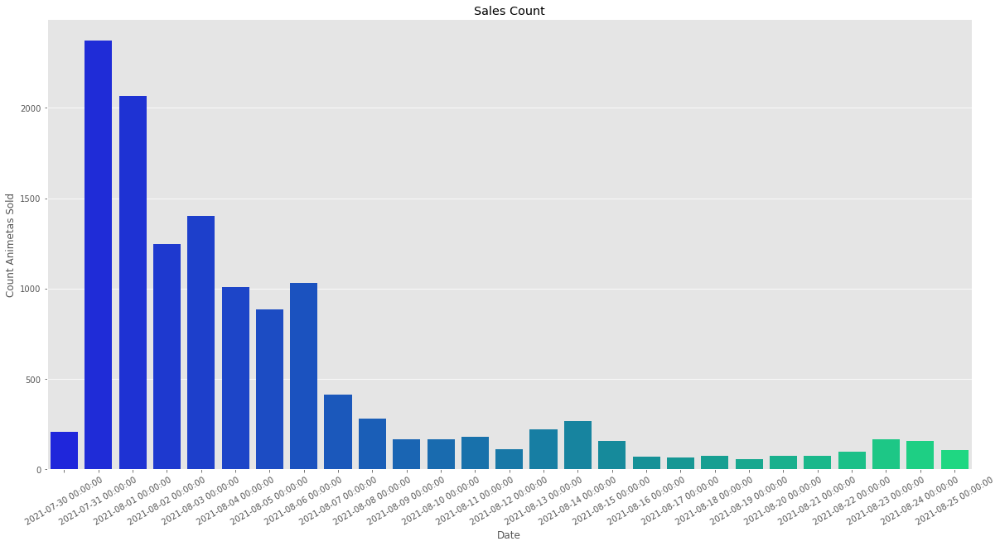

In [31]:
data = animetas_sales_df[['timestamp', 'total_price']].resample('D', on='timestamp').count()['total_price']
data = pd.DataFrame(data)
data.columns = ['Count Animetas Sold']
#ax = data.plot.bar(figsize=(18, 5))

plt.figure(figsize=(20,10))
ax = sns.barplot(x=data.index, y=data['Count Animetas Sold'], palette="winter")
plt.xlabel("Date")
plt.title("Sales Count")
ax.set_xticklabels(ax.get_xticklabels(),rotation = 30);
#ax.xaxis.set_major_locator(plt.MaxNLocator(100));

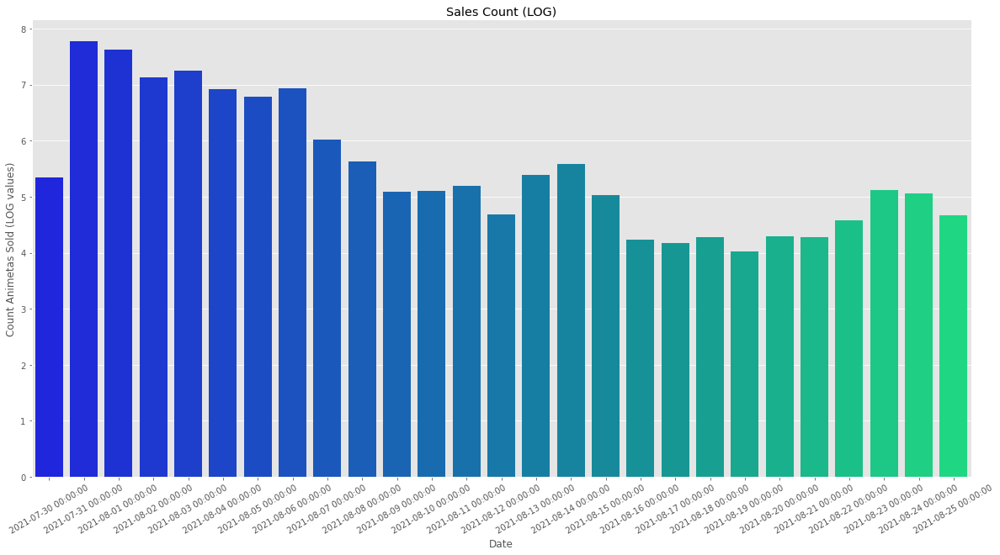

In [32]:
data = animetas_sales_df[['timestamp', 'total_price']].resample('D', on='timestamp').count()['total_price']
data = pd.DataFrame(data)
data.columns = ['Count Animetas Sold']
data['Count Animetas Sold'] = np.log(data['Count Animetas Sold'])
#ax = data.plot.bar(figsize=(18, 5))

plt.figure(figsize=(20,10))
ax = sns.barplot(x=data.index, y=data['Count Animetas Sold'], palette="winter")
plt.xlabel("Date")
plt.ylabel("Count Animetas Sold (LOG values)")
plt.title("Sales Count (LOG)")
ax.set_xticklabels(ax.get_xticklabels(),rotation = 30);
#ax.xaxis.set_major_locator(plt.MaxNLocator(100));

#### Total Sales per Day in ETH

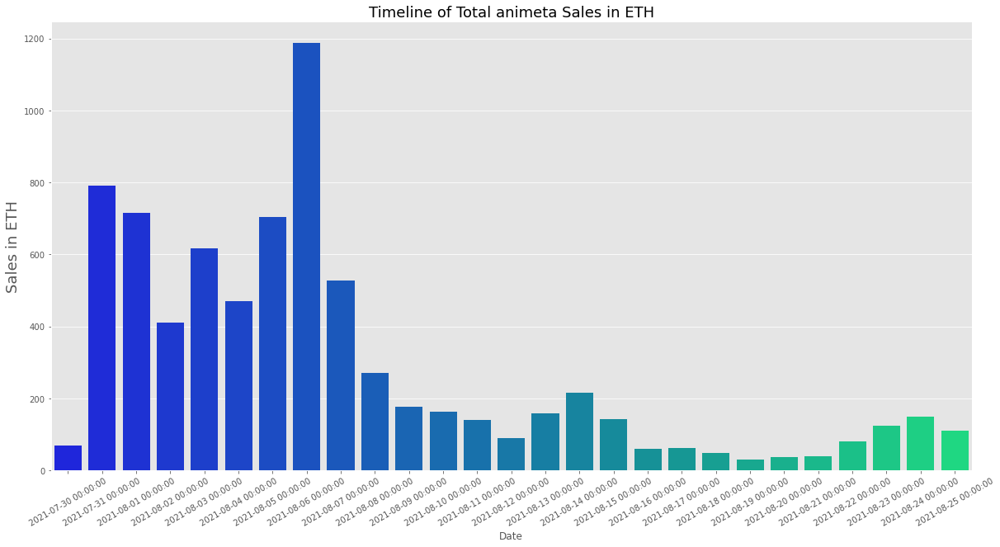

In [33]:
data = animetas_sales_df[['timestamp', 'total_price']].resample('D', on='timestamp').sum()['total_price']
data = pd.DataFrame(data)
data.columns = ['total_price']

plt.figure(figsize=(20,10))
ax=sns.barplot(x=data.index, y=data['total_price'], palette="winter")
plt.xlabel("Date")
plt.title("Sales Count")

ax.set_title("Timeline of Total animeta Sales in ETH", fontsize=18)
ax.set_ylabel("Sales in ETH", fontsize=18);
ax.set_xticklabels(ax.get_xticklabels(),rotation = 30);


#### Total Sales per day in USD

<ipython-input-34-a6ddfbb4e3dd>:12: MatplotlibDeprecationWarning: The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  ax.annotate(s="{:.2f}".format(j/10.**6), xy=(i, j), rotation=45)


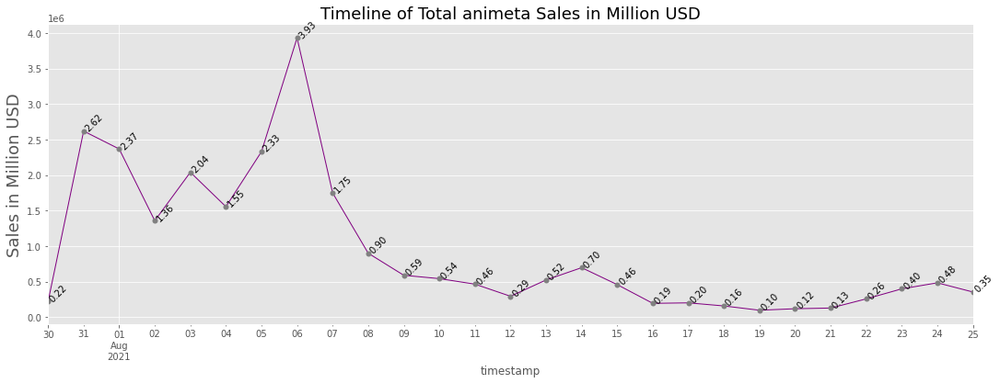

In [34]:
data = animetas_sales_df[['timestamp', 'total_price_usd']].resample('D', on='timestamp').sum()['total_price_usd']
ax = data.plot(figsize=(18,6), color="purple", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Total animeta Sales in Million USD", fontsize=18)
ax.set_ylabel("Sales in Million USD", fontsize=18);

dates = list(data.index)
values = list(data.values)

for i, j in zip(dates, values):
    ax.annotate(s="{:.2f}".format(j/10.**6), xy=(i, j), rotation=45)

### 2.2.6. animetas Prices Timelines 

#### Average animeta Price per Day in ETH 

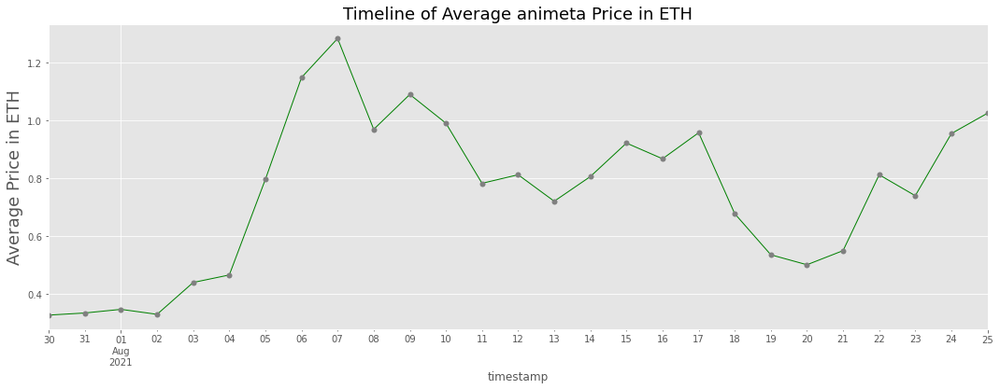

In [35]:
data = animetas_sales_df[['timestamp', 'total_price']].resample('D', on='timestamp').mean()['total_price']
ax = data.plot(figsize=(18,6), color="green", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Average animeta Price in ETH", fontsize=18)
ax.set_ylabel("Average Price in ETH", fontsize=18);
#ax.annotate(s='sdsdsds', xy=(1, 1))

dates = list(data.index)
values = list(data.values)

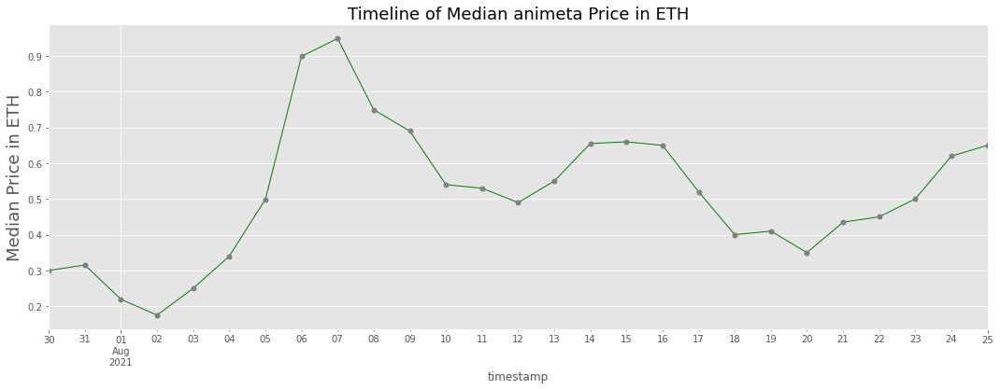

In [36]:
data = animetas_sales_df[['timestamp', 'total_price']].resample('D', on='timestamp').median()['total_price']
ax = data.plot(figsize=(18,6), color="green", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Median animeta Price in ETH", fontsize=18)
ax.set_ylabel("Median Price in ETH", fontsize=18);
#ax.annotate(s='sdsdsds', xy=(1, 1))

dates = list(data.index)
values = list(data.values)

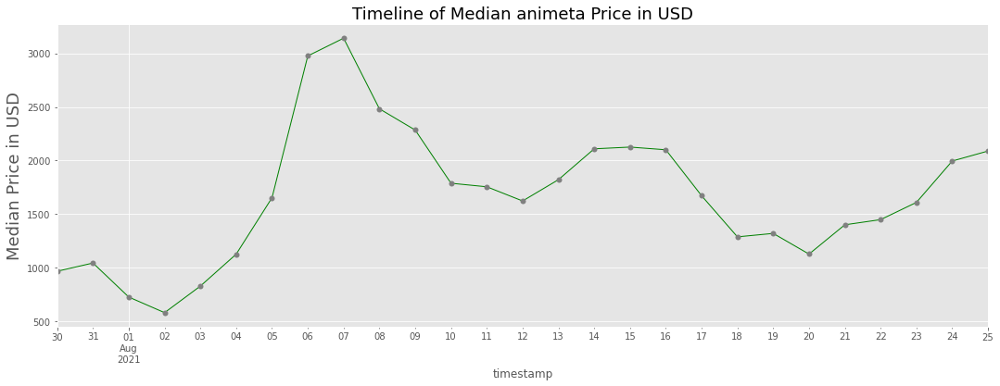

In [37]:
data = animetas_sales_df[['timestamp', 'total_price_usd']].resample('D', on='timestamp').median()['total_price_usd']
ax = data.plot(figsize=(18,6), color="green", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Median animeta Price in USD", fontsize=18)
ax.set_ylabel("Median Price in USD", fontsize=18);
#ax.annotate(s='sdsdsds', xy=(1, 1))

dates = list(data.index)
values = list(data.values)

#### Floor animeta Price per Day in ETH

<ipython-input-38-4d49b8c1fcc1>:13: MatplotlibDeprecationWarning: The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  ax.annotate(s="{:.5f}".format(v), xy=(d, v), rotation=45)


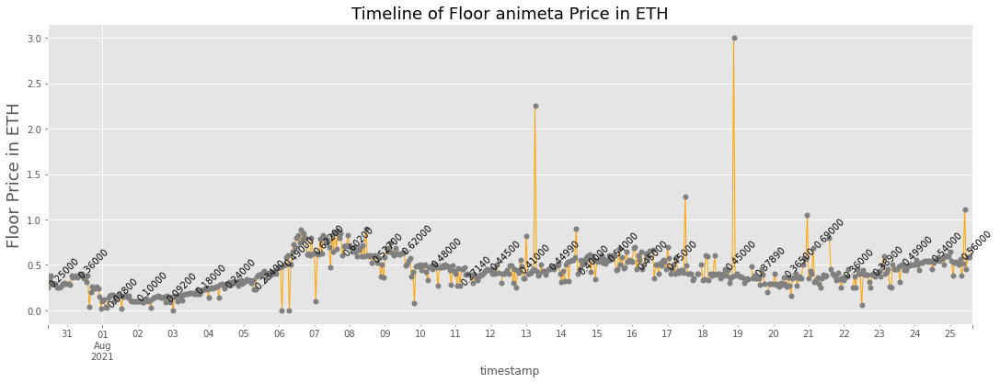

In [38]:
data = animetas_sales_df[['timestamp', 'total_price']].resample('H', on='timestamp').min()['total_price']
ax = data.plot(figsize=(18,6), color="orange", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Floor animeta Price in ETH", fontsize=18)
ax.set_ylabel("Floor Price in ETH", fontsize=18);

dates = list(data.index)
values = list(data.values)

for idx, (d, v) in enumerate(zip(dates, values)):
    if idx%20 == 0:
        ax.annotate(s="{:.5f}".format(v), xy=(d, v), rotation=45)

#### Max animeta Price per Day in ETH

<ipython-input-39-9758a9d146b2>:12: MatplotlibDeprecationWarning: The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  ax.annotate(s="{:.0f}".format(j), xy=(i, j+1), rotation=45)


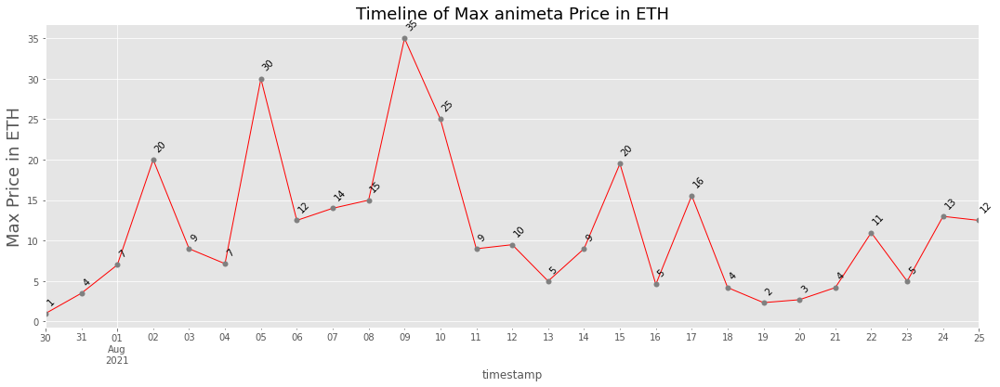

In [39]:
data = animetas_sales_df[['timestamp', 'total_price']].resample('D', on='timestamp').max()['total_price']
ax = data.plot(figsize=(18,6), color="red", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Max animeta Price in ETH", fontsize=18)
ax.set_ylabel("Max Price in ETH", fontsize=18);

dates = list(data.index)
values = list(data.values)

for i, j in zip(dates, values):
    ax.annotate(s="{:.0f}".format(j), xy=(i, j+1), rotation=45)

### Animetas Listings Timelines

#### Total Number of listings per Day

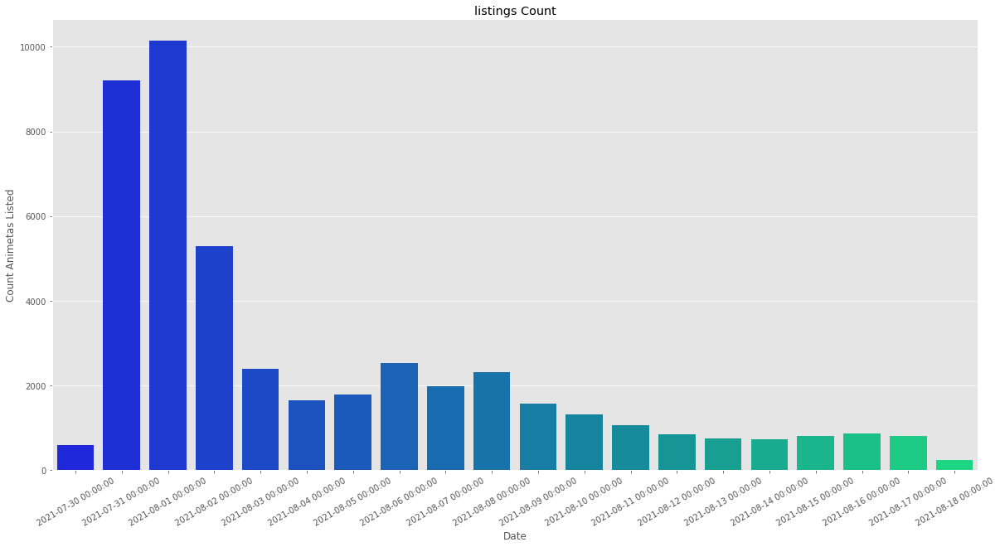

In [40]:
data = animetas_listings_df[['created_date', 'starting_price']].resample('D', on='created_date').count()['starting_price']
data = pd.DataFrame(data)
data.columns = ['Count Animetas Listed']
#ax = data.plot.bar(figsize=(18, 5))

plt.figure(figsize=(20,10))
ax = sns.barplot(x=data.index, y=data['Count Animetas Listed'], palette="winter")
plt.xlabel("Date")
plt.title("listings Count")
ax.set_xticklabels(ax.get_xticklabels(),rotation = 30);

#### Total listings per Day in ETH

In [41]:
pd.set_option('display.max_columns', None) # display all columns
pd.set_option('display.max_rows', None) # display all columns
animetas_listings_df

,is_bundle,animeta_id,seller_address,seller_username,created_date,starting_price,payment_token,usd_price,total_price_usd
0,False,1006,0xc53f5a27021455293aa34da308280abc4cad210a,dminer-eth,2021-07-30 23:58:53.710235,2.999000e-01,ETH,3311.27,9.930499e+02
1,False,638,0x7c8f4a31bfa6a2bc70e538dec4636da3c531abe8,NanoChip,2021-07-30 23:50:40.314459,2.950000e-01,ETH,3311.27,9.768246e+02
2,False,618,0x78c4b4a8bb8c7366b80f470d7dbeb3932e5261af,iJackie,2021-07-30 23:50:19.138101,3.200000e-01,ETH,3311.27,1.059606e+03
3,False,693,0x88ffb3edf7ba0b31044f7fbb9a9e9d64854f0e15,Dadadariel,2021-07-30 23:47:42.395583,3.250000e-01,ETH,3311.27,1.076163e+03
4,False,472,0x59265c2f1e8cfc6ce4d918da3df3f160d75568ea,Mantaroth,2021-07-30 23:44:05.703537,2.900000e-01,ETH,3311.27,9.602683e+02
5,False,1006,0xc53f5a27021455293aa34da308280abc4cad210a,dminer-eth,2021-07-30 23:43:04.614863,2.999000e-01,ETH,3311.27,9.930499e+02
6,False,524,0x65217c49f9f1c4b5d468bcbf2942310cff530df1,C9F8EJJ8ED,2021-07-30 23:41:47.952432,3.000000e-01,ETH,3311.27,9.933810e+02
7,False,524,0x65217c49f9f1c4b5d468bcbf2942310cff530df1,C9F8EJJ8ED,2021-07-30 23:41:43.247646,3.000000e-01,ETH,3311.27,9.933810e+02
8,False,206,0x259ce2e7c5c2e239ff27be9cc4dbf8b73cad63ac,Kelekin,2021-07-30 23:37:12.633625,3.500000e-01,ETH,3311.27,1.158944e+03
9,False,433,0x2859cf5dae020a9314f5ff659c8214ff243164c1,jellonft,2021-07-30 23:33:54.097709,3.000000e-01,ETH,3311.27,9.933810e+02


In [42]:
data

,Count Animetas Listed
created_date,
2021-07-30,585
2021-07-31,9198
2021-08-01,10139
2021-08-02,5282
2021-08-03,2395
2021-08-04,1640
2021-08-05,1774
2021-08-06,2530
2021-08-07,1981


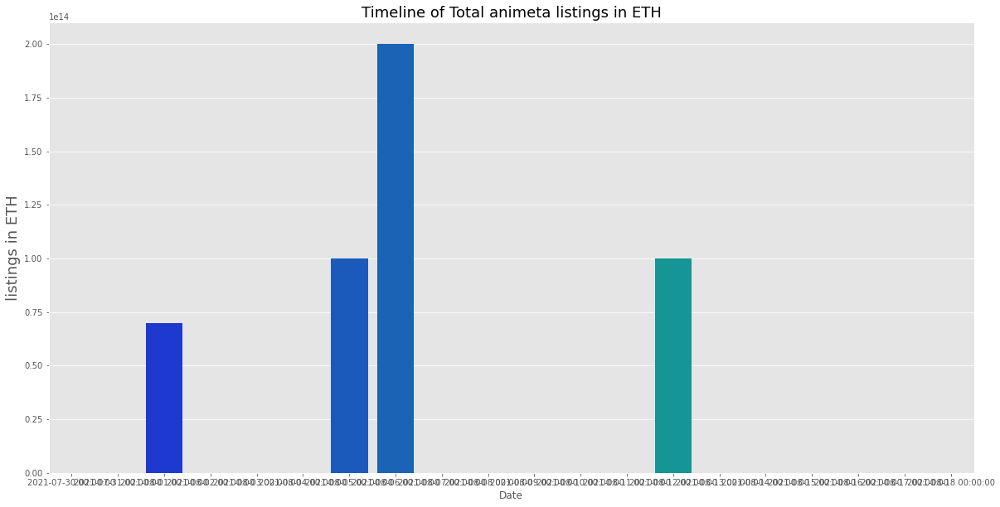

In [43]:
data = animetas_listings_df[['created_date', 'starting_price']].resample('D', on='created_date').sum()['starting_price']
data = pd.DataFrame(data)
data.columns = ['starting_price']

plt.figure(figsize=(20,10))
ax=sns.barplot(x=data.index, y=data['starting_price'],data=data, palette="winter")
plt.xlabel("Date")
plt.title("listings Count")

ax.set_title("Timeline of Total animeta listings in ETH", fontsize=18)
ax.set_ylabel("listings in ETH", fontsize=18);


#### Total listings per day in USD

<ipython-input-44-67796e217cd8>:13: MatplotlibDeprecationWarning: The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  ax.annotate(s="{:.2f}".format(j/10.**6), xy=(i, j), rotation=45)


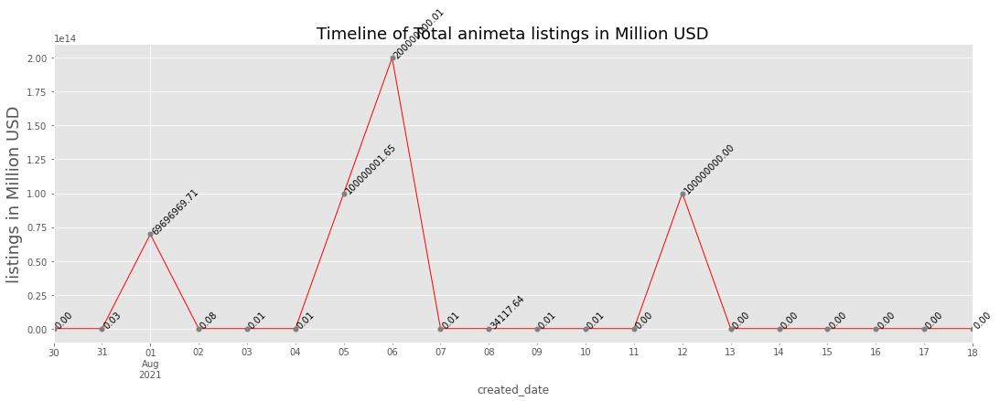

In [44]:
data = animetas_listings_df[['created_date', 'starting_price']].resample('D', on='created_date').sum()['starting_price']
ax = data.plot(figsize=(18,6), color="red", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Total animeta listings in Million USD", fontsize=18)
ax.set_ylabel("listings in Million USD", fontsize=18);


dates = list(data.index)
values = list(data.values)

for i, j in zip(dates, values):
    ax.annotate(s="{:.2f}".format(j/10.**6), xy=(i, j), rotation=45)

### Animetas Prices Timelines 

#### Average animeta Price per Day in ETH 

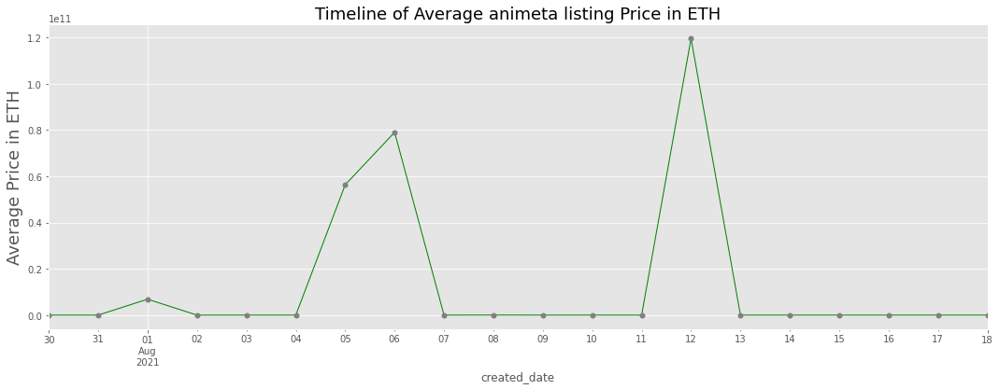

In [45]:
data = animetas_listings_df[['created_date', 'starting_price']].resample('D', on='created_date').mean()['starting_price']
ax = data.plot(figsize=(18,6), color="green", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Average animeta listing Price in ETH", fontsize=18)
ax.set_ylabel("Average Price in ETH", fontsize=18);
#ax.annotate(s='sdsdsds', xy=(1, 1))

dates = list(data.index)
values = list(data.values)

#### Floor animeta Price per Day in ETH

<ipython-input-46-e8a023347866>:13: MatplotlibDeprecationWarning: The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  ax.annotate(s="{:.5f}".format(v), xy=(d, v), rotation=45)


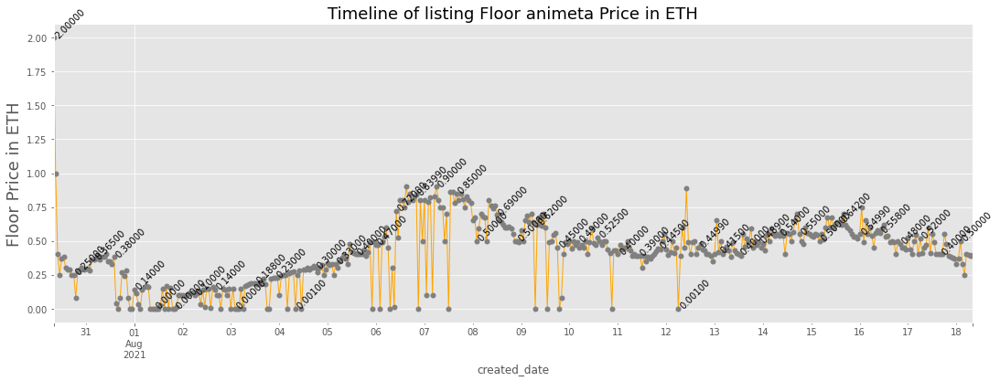

In [46]:
data = animetas_listings_df[['created_date', 'starting_price']].resample('H', on='created_date').min()['starting_price']
ax = data.plot(figsize=(18,6), color="orange", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of listing Floor animeta Price in ETH", fontsize=18)
ax.set_ylabel("Floor Price in ETH", fontsize=18);

dates = list(data.index)
values = list(data.values)

for idx, (d, v) in enumerate(zip(dates, values)):
    if idx%10 == 0:
        ax.annotate(s="{:.5f}".format(v), xy=(d, v), rotation=45)

#### Max animeta Price per Day in ETH

<ipython-input-47-6fcc6ff4f203>:12: MatplotlibDeprecationWarning: The 's' parameter of annotate() has been renamed 'text' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  ax.annotate(s="{:.0f}".format(j), xy=(i, j+30), rotation=45)


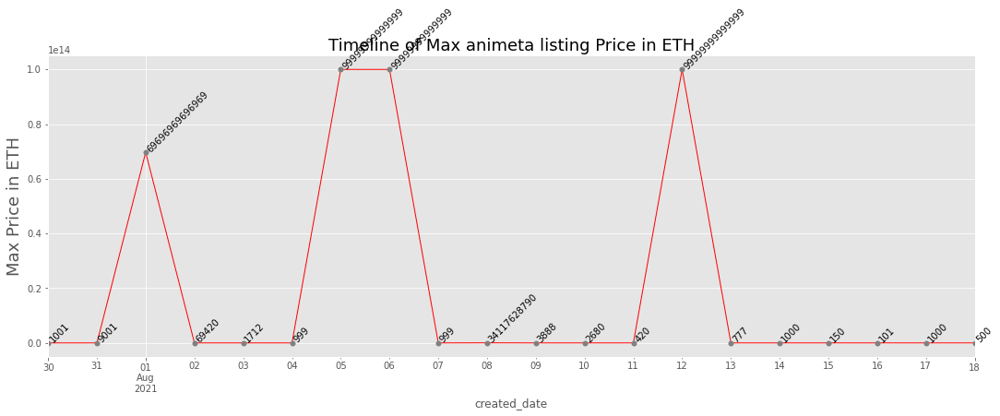

In [47]:
data = animetas_listings_df[['created_date', 'starting_price']].resample('D', on='created_date').max()['starting_price']
ax = data.plot(figsize=(18,6), color="red", linewidth=1, marker='o', markerfacecolor='grey', markeredgewidth=0)

ax.set_alpha(0.8)
ax.set_title("Timeline of Max animeta listing Price in ETH", fontsize=18)
ax.set_ylabel("Max Price in ETH", fontsize=18);

dates = list(data.index)
values = list(data.values)

for i, j in zip(dates, values):
    ax.annotate(s="{:.0f}".format(j), xy=(i, j+30), rotation=45)

## Sales by Trait <a class="anchor" id="trait"></a>

#### Create dictionaries for each trait + fill their values with df's of all of the sales of assets with that trait
#### *Note: Very not-optimized. Takes a lot of time and may crash the notebook depending on sales volume

In [48]:
# make arrays for all of the traits e.g. eye type, weapon type, etc. and values e.g. blue, submachine gun, etc.
def create_trait_value_dicts(animetas_df):
    all_traits = []
    all_values = []
    for meta in animetas_df['traits']:
        for trait in meta:
            if trait['value'] not in all_values:
                all_values.append(trait['value'])
            if trait['trait_type'] not in all_traits:
                all_traits.append(trait['trait_type'])
    # create dictionaries to keep track of all sales for each trait
    sales_values_dict = dict.fromkeys(all_values,pd.DataFrame(columns=animetas_sales_df.columns))
    # create dictionaries to keep track of all listings for each trait
    listings_values_dict = dict.fromkeys(all_values,pd.DataFrame(columns=animetas_listings_df.columns))
    
    return sales_values_dict,listings_values_dict

In [49]:
sales_values_dict, listings_values_dict = create_trait_value_dicts(animetas_df)

In [50]:
# fill dictionary of every trait value with all sales from for that value 
def fill_sales_values_dict(sales_values_dict,animetas_sales_df,animetas_df):
    # Time consuming to access value in dictionary in list in dataframe, how to optimize?
    # Fill each sales values dictionary entry with a dataframe of all sales involving that trait 
    count = 0
    start_time = time.time()
    for index, row in animetas_sales_df.iterrows():
        if index % 1000 == 0:
            print(index,len(animetas_sales_df['animeta_id']))
            print("--- %s seconds ---" % (time.time() - start_time))
        traits = animetas_df.loc[animetas_df['animeta_id'] == row['animeta_id']]['traits'].values[0]
        for trait in traits:
            sales_values_dict[trait['value']] = sales_values_dict[trait['value']].append(row)
    return sales_values_dict

In [51]:
# fill dictionary of every trait value with all sales from for that value 
def fill_listings_values_dict(listings_values_dict,animetas_sales_df,animetas_df):
    # Time consuming to access value in dictionary in list in dataframe, how to optimize?
    # Fill each listings values dictionary entry with a dataframe of all listings involving that trait 
    count = 0
    start_time = time.time()
    for index, row in animetas_listings_df.iterrows():
        if index % 1000 == 0:
            print(index,len(animetas_listings_df['animeta_id']))
            print("--- %s seconds ---" % (time.time() - start_time))
        traits = animetas_df.loc[animetas_df['animeta_id'] == row['animeta_id']]['traits'].values[0]
        for trait in traits:
            listings_values_dict[trait['value']] = listings_values_dict[trait['value']].append(row)
    return listings_values_dict

In [52]:
sales_values_dict = fill_sales_values_dict(sales_values_dict,animetas_sales_df,animetas_df)

0 13102
--- 0.04002666473388672 seconds ---
1000 13102
--- 41.32728385925293 seconds ---
2000 13102
--- 82.66160607337952 seconds ---
3000 13102
--- 126.97687673568726 seconds ---


KeyboardInterrupt: 

In [ ]:
def visualize_trait_sales(sales_values_dict,trait = "klingon", trait2 = None):
    data = sales_values_dict[trait][['timestamp', 'total_price']];
    data = data.dropna();
    data['date_ordinal'] = pd.to_datetime(data['timestamp']).apply(lambda date: date.toordinal());
    plt.figure(figsize=(20,10));
    ax = sns.regplot(x = data['date_ordinal'], y = data["total_price"], data=data, scatter=True, order = 1,label=trait, color='r');
    ax.set_xlabel('Date of Sale');
    ax.set_ylabel('Price of Sale in ETH');
    new_labels = [date.fromordinal(int(item)) for item in ax.get_xticks()];
    ax.set_xticklabels(new_labels);
    ax.set_title("All sales of Trait Value: " + str(trait));
    if trait2:
        data2 = sales_values_dict[trait2][['timestamp', 'total_price']];
        data2['date_ordinal'] = pd.to_datetime(data2['timestamp']).apply(lambda date: date.toordinal());
        sns.regplot(x = data2['date_ordinal'], y = data2["total_price"], data=data2, scatter=True, order = 1,label=trait2, color='b');
        ax.set_title("All sales of Trait Value: " + str(trait) + " & " + str(trait2));
    ax.legend();
    plt.show()

In [ ]:
def visualize_listings_trait(listings_values_dict,trait = "klingon", trait2 = None):
    data = listings_values_dict[trait][['created_date', 'starting_price']]
    data = data.dropna()
    data['date_ordinal'] = pd.to_datetime(data['created_date']).apply(lambda date: date.toordinal())
    plt.figure(figsize=(20,10))
    ax = sns.regplot(x = data['date_ordinal'], y = data["starting_price"], data=data, scatter=True, order = 3,label=trait, color='r')
    ax.set_xlabel('Date of listing')
    ax.set_ylabel('Price of listing in ETH')
    new_labels = [date.fromordinal(int(item)) for item in ax.get_xticks()]
    ax.set_xticklabels(new_labels)
    ax.set_title("All listings of Trait Value: " + str(trait))
    if trait2:
        data2 = listings_values_dict[trait2][['created_date', 'starting_price']]
        data2['date_ordinal'] = pd.to_datetime(data2['created_date']).apply(lambda date: date.toordinal())
        sns.regplot(x = data2['date_ordinal'], y = data2["starting_price"], data=data2, scatter=True, order = 3,label=trait2, color='b')
        ax.set_title("All listings of Trait Value: " + str(trait) + " & " + str(trait2))
    ax.legend()
    plt.show()

In [ ]:
#listings_values_dict

In [ ]:
visualize_trait_sales(sales_values_dict, trait='black ninja', trait2='white ninja')

In [ ]:
sales_values_dict.keys()


# References

[0] [Data mining Meebits](http://adilmoujahid.com/posts/2021/06/data-mining-meebits-nfts-python-opensea/)

[1] [Fungibility - Wikipedia](https://en.wikipedia.org/wiki/Fungibility)

[2] [A Practical Introduction to NFTs using Solidity and Legos](http://adilmoujahid.com/posts/2021/05/intro-nfts-solidity/)

[3] [Counterparty - Wikipedia](https://bit.ly/3h6IfMU)

[4] [Counterparty - Bitcoinwiki](https://bit.ly/2T79teI)

[5] [Rare Pepe Gets Blockchained, Made Into Tradable Counterparty Tokens](https://news.bitcoin.com/rare-pepe-assets-get-blockchained/)